In [1]:
import pandas as pd
from sklearn.model_selection import train_test_split
import re
from nltk import PorterStemmer
from nltk.corpus import stopwords
from transformers import DistilBertTokenizerFast, TFDistilBertForSequenceClassification
from sklearn.feature_extraction.text import TfidfVectorizer
from collections import Counter
from wordcloud import WordCloud
from nltk.corpus import stopwords
from sklearn.model_selection import train_test_split
import tensorflow as tf
import matplotlib.pyplot as plt

c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Data Understanding

In [2]:
df=pd.read_csv(r"C:\Users\shiva\OneDrive\Desktop\Batch-6\video_platform\testing phase\isspam.csv",encoding='utf-8')

In [3]:
df

,Text,isspam
0,Free money! Click here to claim!,1
1,"Hi, how are you doing?",0
2,Urgent! You've won a prize!,1
3,Meeting tomorrow at 10 AM,0
4,"Congratulations! You are selected, click now!",1
...,...,...
1448,dirtyslut,1
1449,cuntface,1
1450,moddagudu,1
1451,puka,1


In [4]:
df.shape

(1453, 2)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1453 entries, 0 to 1452
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Text    1453 non-null   object
 1   isspam  1453 non-null   int64 
dtypes: int64(1), object(1)
memory usage: 22.8+ KB


# Data Exploration

In [6]:
df.isnull().sum()

Text      0
isspam    0
dtype: int64

In [7]:
max=0
sentence=''
for i in range(len(df['Text'])):
    max_words=len(df['Text'][i])
    if max<max_words:
        max=max_words
        sentence=df['Text'][i]
print("The maximum length of a sentence is:-",max)
print("And the sentence is:-" ,sentence)

               

The maximum length of a sentence is:- 64
And the sentence is:- Congratulations! You have been selected for a free consultation!


In [8]:
vectorizer=TfidfVectorizer(ngram_range=(2,2))

In [9]:
negative=df[df['isspam']==0]

In [10]:
positive=df[df['isspam']==1]

In [11]:
matrix=vectorizer.fit_transform(positive['Text']).toarray()

In [12]:
features=vectorizer.get_feature_names_out()

In [13]:
tf_data=pd.DataFrame(matrix,columns=features)

In [14]:
N = 5

top_features_each_row = {}

for index, row in tf_data.iterrows():
    topN = row.nlargest(N)
    top_features_each_row[index] = list(zip(topN.index, topN.values))

top_features_each_row


{0: [('money click', 0.6461364174654691),
  ('free money', 0.5478306990848397),
  ('to claim', 0.36128781341864563),
  ('here to', 0.3063515441175962),
  ('click here', 0.24085078878227306)],
 1: [('urgent you', 0.6421436967283197),
  ('won prize', 0.6421436967283197),
  ('ve won', 0.3026611978496288),
  ('you ve', 0.28930804485946),
  ('10 minutes', 0.0)],
 2: [('are selected', 0.529815724078959),
  ('selected click', 0.529815724078959),
  ('you are', 0.5005569066895705),
  ('click now', 0.3636585988116753),
  ('congratulations you', 0.23619018547152684)],
 3: [('you subscribe', 0.48350321992969725),
  ('subscribe now', 0.4568019882067292),
  ('offer just', 0.41115593108332366),
  ('just for', 0.37751635747402856),
  ('for you', 0.3655098739599182)],
 4: [('vacation limited', 0.6549738123539719),
  ('time offer', 0.4452130186231299),
  ('limited time', 0.3923071641954629),
  ('win free', 0.3643264927544954),
  ('free vacation', 0.29352337006975665)],
 5: [('1000 per', 0.40442599513088

In [15]:
vectorizer=TfidfVectorizer(ngram_range=(2,2))

In [16]:
matrix2=vectorizer.fit_transform(negative['Text']).toarray()

In [17]:
tf_neg=pd.DataFrame(matrix2,columns=vectorizer.get_feature_names_out())

In [18]:
N = 5

top_features_each_row = {}

for index, row in tf_neg.iterrows():
    topN = row.nlargest(N)
    top_features_each_row[index] = list(zip(topN.index, topN.values))

top_features_each_row


{0: [('hi how', 0.7114459041426071),
  ('you doing', 0.4155127188783038),
  ('are you', 0.4109173279213442),
  ('how are', 0.3903086670099068),
  ('10 am', 0.0)],
 1: [('meeting tomorrow', 0.5187594480317689),
  ('10 am', 0.5076800347565159),
  ('at 10', 0.5076800347565159),
  ('tomorrow at', 0.46412347462396275),
  ('100k subs', 0.0)],
 2: [('about work', 0.4472135954999579),
  ('is legitimate', 0.4472135954999579),
  ('legitimate message', 0.4472135954999579),
  ('message about', 0.4472135954999579),
  ('this is', 0.4472135954999579)],
 3: [('seeing you', 0.46473239495272306),
  ('to seeing', 0.46473239495272306),
  ('you next', 0.46473239495272306),
  ('next week', 0.3586304123576045),
  ('forward to', 0.3342571095554537)],
 4: [('for your', 0.523020638555769),
  ('your email', 0.523020638555769),
  ('you for', 0.48809555855451775),
  ('thank you', 0.46331581994227705),
  ('10 am', 0.0)],
 5: [('delivery is', 0.4897239639721705),
  ('is scheduled', 0.4897239639721705),
  ('your deli

In [19]:
words=' '.join(positive['Text']).split()
Counter(words).most_common(20)

[('free', 608),
 ('your', 416),
 ('a', 355),
 ('to', 308),
 ('Click', 283),
 ('for', 274),
 ('here', 244),
 ('Get', 157),
 ('get', 135),
 ('now', 119),
 ('gift', 119),
 ('F*ck', 117),
 ('Congratulations!', 113),
 ('won', 102),
 ('now!', 96),
 ('Join', 94),
 ('FREE', 74),
 ('claim', 72),
 ('card!', 70),
 ('this', 67)]

In [20]:
words=" ".join(negative['Text']).split()
Counter(words).most_common(20)

[('your', 127),
 ('How’s', 79),
 ('the', 65),
 ('Reminder:', 58),
 ('everything', 58),
 ('with', 51),
 ('by', 43),
 ('you', 42),
 ('going', 41),
 ('at', 38),
 ('Submit', 38),
 ('Meeting', 36),
 ('How', 33),
 ('are', 32),
 ('for', 32),
 ('Your', 31),
 ('to', 28),
 ('tomorrow.', 27),
 ('doing', 27),
 ('PM.', 26)]

(-0.5, 799.5, 399.5, -0.5)

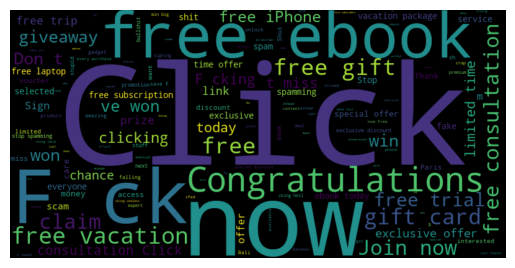

In [21]:
text=" ".join(positive['Text'].apply(str))
word_cloud=WordCloud(width=800,height=400,background_color='black').generate(text)
plt.imshow(word_cloud,interpolation='bilinear')
plt.axis("off")

In [22]:
text=" ".join(negative['Text'].apply(str))
word_cloud=WordCloud(width=800,height=400,background_color='black').generate(text)
plt.figure(figsize=(200,400))
plt.imshow(word_cloud,interpolation='bilinear')
plt.axis("off")
plt.show()

In [23]:
#splitting the data
X=df['Text']
y=df['isspam']

In [24]:
X_train,X_test,y_train,y_test=train_test_split(X,y,train_size=0.8,random_state=42)

# Transforming the data


In [25]:
tokenizer=DistilBertTokenizerFast.from_pretrained('distilbert-base-uncased')

In [26]:
model=TFDistilBertForSequenceClassification.from_pretrained('DistilBert-base-uncased',num_labels=2)

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_transform.bias', 'vocab_layer_norm.weight', 'vocab_projector.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFDistilBertForSequenceClassification from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
Some weights or buffers of the TF 2.0 model TFDistilBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['pre_classifier.weight', 'pre_classifier.bias', 'classifier.weight', 'classifier.bias']
You should 

In [27]:
train_embeddings=tokenizer(
    X_train.tolist(),
    truncation=True,
    padding=True,
    max_length=128
)

In [28]:
test_embeddings=tokenizer(X_test.tolist(),truncation=True,padding=True,max_length=128)

In [29]:
train=tf.data.Dataset.from_tensor_slices((dict(train_embeddings),y_train)).batch(16)

In [30]:
test=tf.data.Dataset.from_tensor_slices((dict(test_embeddings),y_test)).batch(16)

In [ ]:
optimizer=tf.keras.optimizers.Adam(learning_rate=2e-5)
loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
9model.compile(optimizer=optimizer,loss=loss,metrics=['accuracy'])

In [38]:
history=model.fit(train,validation_data=test,epochs=3)

Epoch 1/3




InvalidArgumentError: Graph execution error:

Detected at node sparse_categorical_crossentropy/SparseSoftmaxCrossEntropyWithLogits/SparseSoftmaxCrossEntropyWithLogits defined at (most recent call last):
  File "<frozen runpy>", line 198, in _run_module_as_main

  File "<frozen runpy>", line 88, in _run_code

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\ipykernel_launcher.py", line 18, in <module>

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\traitlets\config\application.py", line 1075, in launch_instance

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\ipykernel\kernelapp.py", line 758, in start

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\tornado\platform\asyncio.py", line 211, in start

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\asyncio\base_events.py", line 641, in run_forever

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\asyncio\base_events.py", line 1986, in _run_once

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\asyncio\events.py", line 88, in _run

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\ipykernel\kernelbase.py", line 701, in shell_main

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\ipykernel\kernelbase.py", line 469, in dispatch_shell

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\ipykernel\ipkernel.py", line 379, in execute_request

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\ipykernel\kernelbase.py", line 899, in execute_request

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\ipykernel\ipkernel.py", line 471, in do_execute

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\ipykernel\zmqshell.py", line 632, in run_cell

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\IPython\core\interactiveshell.py", line 3116, in run_cell

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\IPython\core\interactiveshell.py", line 3171, in _run_cell

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\IPython\core\async_helpers.py", line 128, in _pseudo_sync_runner

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\IPython\core\interactiveshell.py", line 3394, in run_cell_async

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\IPython\core\interactiveshell.py", line 3639, in run_ast_nodes

  File "C:\Users\shiva\AppData\Roaming\Python\Python312\site-packages\IPython\core\interactiveshell.py", line 3699, in run_code

  File "C:\Users\shiva\AppData\Local\Temp\ipykernel_23924\653616613.py", line 1, in <module>

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\site-packages\transformers\modeling_tf_utils.py", line 1229, in fit

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\site-packages\tf_keras\src\utils\traceback_utils.py", line 65, in error_handler

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\site-packages\tf_keras\src\engine\training.py", line 1804, in fit

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\site-packages\tf_keras\src\engine\training.py", line 1398, in train_function

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\site-packages\tf_keras\src\engine\training.py", line 1381, in step_function

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\site-packages\tf_keras\src\engine\training.py", line 1370, in run_step

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\site-packages\transformers\modeling_tf_utils.py", line 1674, in train_step

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\site-packages\tf_keras\src\engine\compile_utils.py", line 277, in __call__

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\site-packages\tf_keras\src\losses.py", line 143, in __call__

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\site-packages\tf_keras\src\losses.py", line 270, in call

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\site-packages\tf_keras\src\losses.py", line 2454, in sparse_categorical_crossentropy

  File "c:\Users\shiva\AppData\Local\Programs\Python\Python312\Lib\site-packages\tf_keras\src\backend.py", line 5777, in sparse_categorical_crossentropy

logits and labels must have the same first dimension, got logits shape [1,16] and labels shape [16]
	 [[{{node sparse_categorical_crossentropy/SparseSoftmaxCrossEntropyWithLogits/SparseSoftmaxCrossEntropyWithLogits}}]] [Op:__inference_train_function_17588]